# Project 3A - Image Warping and Mosaicing

## A.2: Recover Homographies

In [42]:
import numpy as np
import matplotlib.pyplot as plt
import json
from skimage import io
from skimage.color import rgb2gray
import os
import time

In [43]:
#We need to normalize the points so that the centroid is at the origin to account for different scaled pixels 
def normalize_points(pts):
    pts = np.asarray(pts, dtype=np.float64)
    assert pts.ndim == 2 and pts.shape[1] == 2, "pts must be (N,2)"

    centroid = pts.mean(axis=0)
    shifted = pts - centroid
    dists = np.sqrt((shifted**2).sum(axis=1))
    mean_dist = np.maximum(dists.mean(), 1e-8)

    s = np.sqrt(2.0) / mean_dist
    T = np.array([[s, 0, -s*centroid[0]],
                  [0, s, -s*centroid[1]],
                  [0, 0, 1.0]], dtype=np.float64)

    ones = np.ones((pts.shape[0], 1), dtype=np.float64)

    pts_h = np.concatenate([pts, ones], axis=1)
    pts_n = (T @ pts_h.T).T

    return T, pts_n[:, :2]

In [44]:
def computeH(im1_pts, im2_pts, normalize=True):
    im1_pts = np.asarray(im1_pts, dtype=np.float64)
    im2_pts = np.asarray(im2_pts, dtype=np.float64)
    assert im1_pts.shape == im2_pts.shape and im1_pts.shape[0] >= 4

    if normalize:
        T1, pts1 = normalize_points(im1_pts)
        T2, pts2 = normalize_points(im2_pts)
    else:
        T1 = np.eye(3)
        T2 = np.eye(3)
        pts1, pts2 = im1_pts, im2_pts

    # Build least-squares system with h33 = 1 fixed.
    A = []
    b = []
    for (x, y), (u, v) in zip(pts1, pts2):
        #               u = (h11*x + h12*y + h13) / (h31*x + h32*y + 1)
        #               v = (h21*x + h22*y + h23) / (h31*x + h32*y + 1)

        # -x*h11 - y*h12 - 1*h13 + u*x*h31 + u*y*h32 = -u
        # -x*h21 - y*h22 - 1*h23 + v*x*h31 + v*y*h32 = -v
        A.append([-x, -y, -1,  0,  0,  0,  u*x, u*y])
        b.append(-u)
        A.append([ 0,  0,  0, -x, -y, -1,  v*x, v*y])
        b.append(-v)

    A = np.array(A)
    b = np.array(b)

    # Solve A h = b least-squares
    x, _, _, _ = np.linalg.lstsq(A, b, rcond=None)

    # Reconstruct full H (h33 = 1)
    h11, h12, h13, h21, h22, h23, h31, h32 = x
    H_tilde = np.array([
        [h11, h12, h13],
        [h21, h22, h23],
        [h31, h32, 1.0]
    ])

    H = np.linalg.inv(T2) @ H_tilde @ T1
    H /= H[2, 2]
    return H

### Example 1: A2 Left-Right Images at Willard Park :))


In [45]:
with open('a2_left_right.json', 'r') as f:
    corr_data = json.load(f)

im1_pts = np.array(corr_data['im1Points'], dtype=np.float64)
im2_pts = np.array(corr_data['im2Points'], dtype=np.float64)

print(f"Loaded {len(im1_pts)} correspondences")

Loaded 25 correspondences


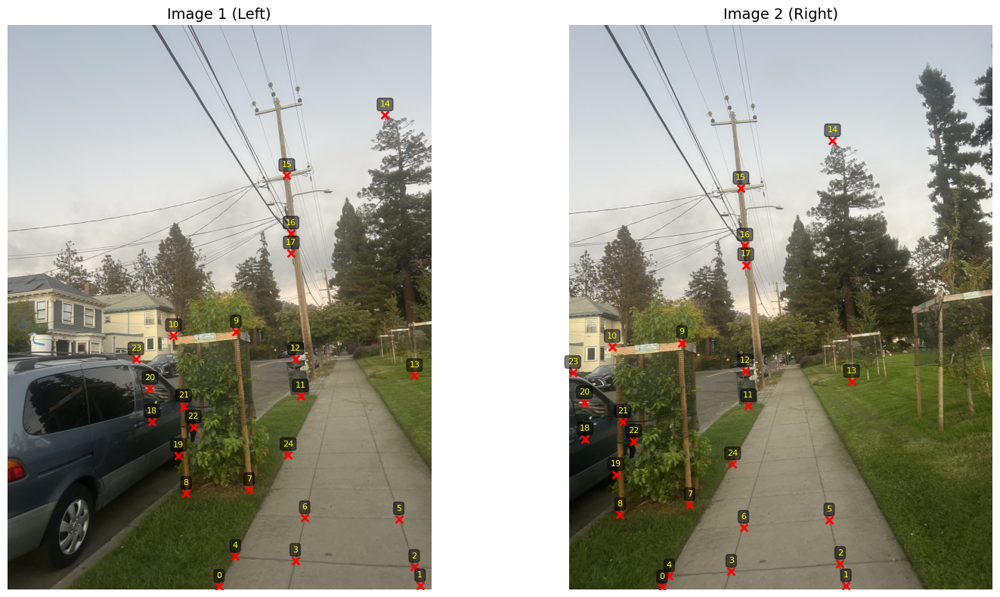

In [46]:
im1 = io.imread('a2left.jpg')
im2 = io.imread('a2right.jpg')

fig, axes = plt.subplots(1, 2, figsize=(16, 8))

axes[0].imshow(im1)
axes[0].scatter(im1_pts[:, 0], im1_pts[:, 1], c='red', s=50, marker='x', linewidths=2)
for i, (x, y) in enumerate(im1_pts):
    axes[0].text(x, y-30, str(i), color='yellow', fontsize=8, ha='center', 
                bbox=dict(boxstyle='round,pad=0.3', facecolor='black', alpha=0.5))
axes[0].set_title('Image 1 (Left)', fontsize=14)
axes[0].axis('off')

axes[1].imshow(im2)
axes[1].scatter(im2_pts[:, 0], im2_pts[:, 1], c='red', s=50, marker='x', linewidths=2)
for i, (x, y) in enumerate(im2_pts):
    axes[1].text(x, y-30, str(i), color='yellow', fontsize=8, ha='center',
                bbox=dict(boxstyle='round,pad=0.3', facecolor='black', alpha=0.5))
axes[1].set_title('Image 2 (Right)', fontsize=14)
axes[1].axis('off')

plt.tight_layout()
plt.savefig('a2_correspondences.jpg', dpi=150, bbox_inches='tight')
plt.show()


In [47]:
T1, pts1 = normalize_points(im1_pts)
T2, pts2 = normalize_points(im2_pts)

print("System of Equations: Ah = b")
print(f"With {len(pts1)} correspondences => {2*len(pts1)} equations for 8 unknowns")


A = []
b = []
for (x, y), (u, v) in zip(pts1, pts2):
    A.append([-x, -y, -1,  0,  0,  0,  u*x, u*y])
    b.append(-u)
    A.append([ 0,  0,  0, -x, -y, -1,  v*x, v*y])
    b.append(-v)

A = np.array(A)
b = np.array(b)

for i in range(len(A)):
    correspondence_num = i // 2
    eq_type = "u" if i % 2 == 0 else "v"
    eq_str = f"Eq {i+1:2d} (Corr {correspondence_num:2d}, {eq_type}): ["
    for j in range(8):
        eq_str += f"{A[i,j]:8.4f}"
        if j < 7:
            eq_str += ", "
    eq_str += f"] = {b[i]:8.4f}"
    print(eq_str)

System of Equations: Ah = b
With 25 correspondences => 50 equations for 8 unknowns
Eq  1 (Corr  0, u): [  0.4949,  -1.7703,  -1.0000,   0.0000,   0.0000,   0.0000,   0.2316,  -0.8283] =   0.4679
Eq  2 (Corr  0, v): [  0.0000,   0.0000,   0.0000,   0.4949,  -1.7703,  -1.0000,  -0.8253,   2.9521] =  -1.6676
Eq  3 (Corr  1, u): [ -1.5749,  -1.7645,  -1.0000,   0.0000,   0.0000,   0.0000,   2.2605,   2.5326] =  -1.4353
Eq  4 (Corr  1, v): [  0.0000,   0.0000,   0.0000,  -1.5749,  -1.7645,  -1.0000,   2.6036,   2.9170] =  -1.6531
Eq  5 (Corr  2, u): [ -1.5144,  -1.5656,  -1.0000,   0.0000,   0.0000,   0.0000,   2.0815,   2.1519] =  -1.3745
Eq  6 (Corr  2, v): [  0.0000,   0.0000,   0.0000,  -1.5144,  -1.5656,  -1.0000,   2.1525,   2.2253] =  -1.4214
Eq  7 (Corr  3, u): [ -0.2892,  -1.5022,  -1.0000,   0.0000,   0.0000,   0.0000,   0.0716,   0.3720] =  -0.2476
Eq  8 (Corr  3, v): [  0.0000,   0.0000,   0.0000,  -0.2892,  -1.5022,  -1.0000,   0.4345,   2.2570] =  -1.5025
Eq  9 (Corr  4, u): [

In [48]:
H = computeH(im1_pts, im2_pts, normalize=True)

print("\nRecovered Homography Matrix H:")
print(H)


Recovered Homography Matrix H:
[[ 1.25965271e+00 -4.47193026e-02 -5.15388894e+02]
 [ 2.04026908e-01  1.17932617e+00 -1.54973764e+02]
 [ 1.65831711e-04  9.97615699e-06  1.00000000e+00]]


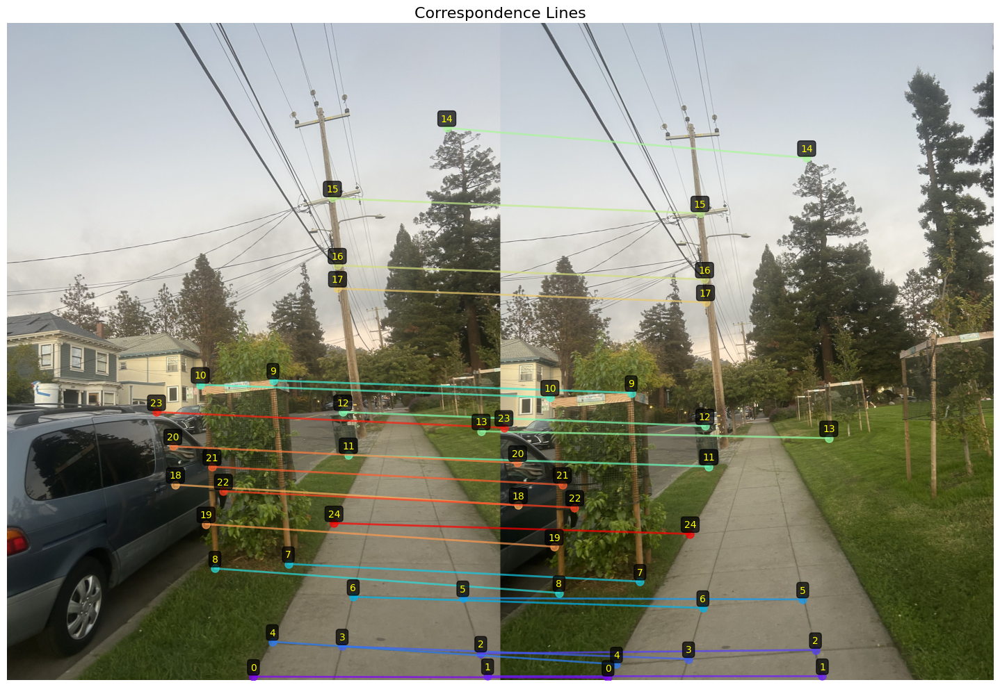

In [49]:
h1, w1 = im1.shape[:2]
h2, w2 = im2.shape[:2]
max_h = max(h1, h2)
combined_w = w1 + w2
combined = np.zeros((max_h, combined_w, 3), dtype=im1.dtype)
combined[:h1, :w1] = im1
combined[:h2, w1:w1+w2] = im2

plt.figure(figsize=(20, 10))
plt.imshow(combined)

step = max(1, len(im1_pts) // 15)
colors = plt.cm.rainbow(np.linspace(0, 1, len(im1_pts)))

for i in range(0, len(im1_pts), step):
    x1, y1 = im1_pts[i]
    x2, y2 = im2_pts[i]
    
    # Offset second image points
    x2_offset = x2 + w1
    
    plt.plot([x1, x2_offset], [y1, y2], 'o-', 
             color=colors[i], linewidth=2, markersize=8, alpha=0.7)
    
    # Add point numbers
    plt.text(x1, y1-20, str(i), color='yellow', fontsize=10, ha='center',
            bbox=dict(boxstyle='round,pad=0.3', facecolor='black', alpha=0.7))
    plt.text(x2_offset, y2-20, str(i), color='yellow', fontsize=10, ha='center',
            bbox=dict(boxstyle='round,pad=0.3', facecolor='black', alpha=0.7))

plt.title('Correspondence Lines', fontsize=16)
plt.axis('off')
plt.tight_layout()
plt.savefig('a2_correspondence_lines.jpg', dpi=150, bbox_inches='tight')
plt.show()




### Example 2: Center-Right View of Campanile at Strawberry Creek


In [50]:
# Load correspondence points for center-right pair
with open('campanile_center_right.json', 'r') as f:
    corr_data_cr = json.load(f)

# Extract points
im1_pts_cr = np.array(corr_data_cr['im1Points'], dtype=np.float64)
im2_pts_cr = np.array(corr_data_cr['im2Points'], dtype=np.float64)

print(f"Loaded {len(im1_pts_cr)} correspondence point pairs")


Loaded 4 correspondence point pairs


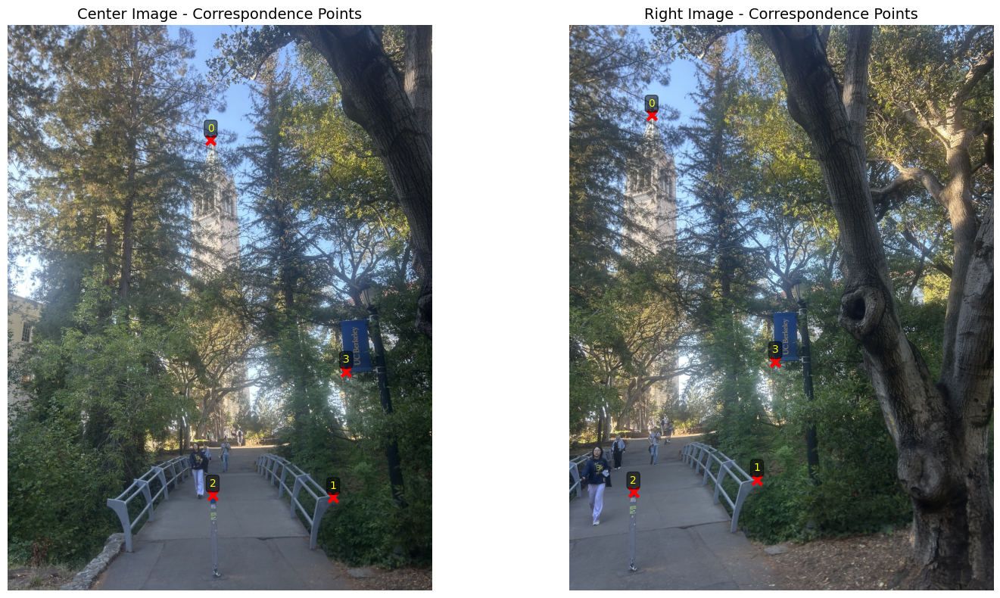

In [51]:
# Load images
im_center = io.imread('center.jpg')
im_right = io.imread('right.jpg')

# Visualize correspondences
fig, axes = plt.subplots(1, 2, figsize=(16, 8))

# Plot center image with points
axes[0].imshow(im_center)
axes[0].scatter(im1_pts_cr[:, 0], im1_pts_cr[:, 1], c='red', s=80, marker='x', linewidths=3)
for i, (x, y) in enumerate(im1_pts_cr):
    axes[0].text(x, y-30, str(i), color='yellow', fontsize=10, ha='center', 
                bbox=dict(boxstyle='round,pad=0.3', facecolor='black', alpha=0.5))
axes[0].set_title('Center Image - Correspondence Points', fontsize=14)
axes[0].axis('off')

# Plot right image with points
axes[1].imshow(im_right)
axes[1].scatter(im2_pts_cr[:, 0], im2_pts_cr[:, 1], c='red', s=80, marker='x', linewidths=3)
for i, (x, y) in enumerate(im2_pts_cr):
    axes[1].text(x, y-30, str(i), color='yellow', fontsize=10, ha='center',
                bbox=dict(boxstyle='round,pad=0.3', facecolor='black', alpha=0.5))
axes[1].set_title('Right Image - Correspondence Points', fontsize=14)
axes[1].axis('off')

plt.tight_layout()
plt.savefig('center_right_correspondences.jpg', dpi=150, bbox_inches='tight')
plt.show()


In [52]:
# Build the system of equations again
T1_cr, pts1_cr = normalize_points(im1_pts_cr)
T2_cr, pts2_cr = normalize_points(im2_pts_cr)

# Build A and b matrices
A_cr = []
b_cr = []
for (x, y), (u, v) in zip(pts1_cr, pts2_cr):
    A_cr.append([-x, -y, -1,  0,  0,  0,  u*x, u*y])
    b_cr.append(-u)
    A_cr.append([ 0,  0,  0, -x, -y, -1,  v*x, v*y])
    b_cr.append(-v)

A_cr = np.array(A_cr)
b_cr = np.array(b_cr)


for i in range(len(A_cr)):
    correspondence_num = i // 2
    eq_type = "u-equation" if i % 2 == 0 else "v-equation"
    
    # Format the equation
    eq_str = f"Eq {i+1:2d} (Corr {correspondence_num:2d}, {eq_type}): ["
    for j in range(8):
        eq_str += f"{A_cr[i,j]:8.4f}"
        if j < 7:
            eq_str += ", "
    eq_str += f"] = {b_cr[i]:8.4f}"
    print(eq_str)


Eq  1 (Corr  0, u-equation): [  0.6289,   2.2835,  -1.0000,   0.0000,   0.0000,   0.0000,   0.3124,   1.1343] =   0.4967
Eq  2 (Corr  0, v-equation): [  0.0000,   0.0000,   0.0000,   0.6289,   2.2835,  -1.0000,   1.4635,   5.3142] =   2.3272
Eq  3 (Corr  1, u-equation): [ -0.5570,  -1.1764,  -1.0000,   0.0000,   0.0000,   0.0000,   0.2767,   0.5844] =  -0.4967
Eq  4 (Corr  1, v-equation): [  0.0000,   0.0000,   0.0000,  -0.5570,  -1.1764,  -1.0000,   0.6170,   1.3032] =  -1.1078
Eq  5 (Corr  2, u-equation): [  0.6099,  -1.1520,  -1.0000,   0.0000,   0.0000,   0.0000,   0.4077,  -0.7701] =   0.6685
Eq  6 (Corr  2, v-equation): [  0.0000,   0.0000,   0.0000,   0.6099,  -1.1520,  -1.0000,  -0.7465,   1.4100] =  -1.2240
Eq  7 (Corr  3, u-equation): [ -0.6818,   0.0448,  -1.0000,   0.0000,   0.0000,   0.0000,   0.4558,  -0.0299] =  -0.6685
Eq  8 (Corr  3, v-equation): [  0.0000,   0.0000,   0.0000,  -0.6818,   0.0448,  -1.0000,  -0.0032,   0.0002] =   0.0046


In [53]:
# Compute homography for center-right pair
H_cr = computeH(im1_pts_cr, im2_pts_cr, normalize=True)

print("Recovered Homography Matrix H_cr:")
print(H_cr)


Recovered Homography Matrix H_cr:
[[ 1.58561381e+00 -7.25189509e-02 -7.41536337e+02]
 [ 4.63038690e-01  1.37287860e+00 -4.86638181e+02]
 [ 3.85086877e-04  6.81732362e-06  1.00000000e+00]]


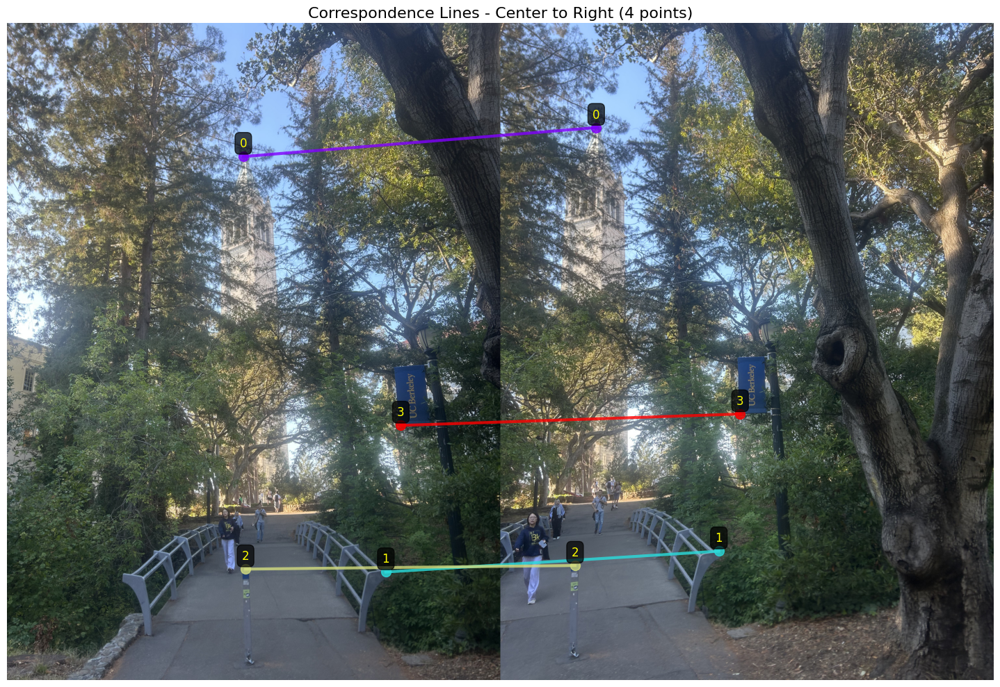

In [54]:
# Create side-by-side visualization with correspondence lines
h1_cr, w1_cr = im_center.shape[:2]
h2_cr, w2_cr = im_right.shape[:2]
max_h_cr = max(h1_cr, h2_cr)
combined_w_cr = w1_cr + w2_cr
combined_cr = np.zeros((max_h_cr, combined_w_cr, 3), dtype=im_center.dtype)
combined_cr[:h1_cr, :w1_cr] = im_center
combined_cr[:h2_cr, w1_cr:w1_cr+w2_cr] = im_right

plt.figure(figsize=(20, 10))
plt.imshow(combined_cr)

# Draw all correspondence lines
colors_cr = plt.cm.rainbow(np.linspace(0, 1, len(im1_pts_cr)))

for i in range(len(im1_pts_cr)):
    x1, y1 = im1_pts_cr[i]
    x2, y2 = im2_pts_cr[i]
    x2_offset = x2 + w1_cr
    
    plt.plot([x1, x2_offset], [y1, y2], 'o-', 
             color=colors_cr[i], linewidth=3, markersize=10, alpha=0.8)
    plt.text(x1, y1-30, str(i), color='yellow', fontsize=12, ha='center',
            bbox=dict(boxstyle='round,pad=0.4', facecolor='black', alpha=0.7))
    plt.text(x2_offset, y2-30, str(i), color='yellow', fontsize=12, ha='center',
            bbox=dict(boxstyle='round,pad=0.4', facecolor='black', alpha=0.7))

plt.title(f'Correspondence Lines - Center to Right ({len(im1_pts_cr)} points)', fontsize=16)
plt.axis('off')
plt.tight_layout()
plt.savefig('center_right_correspondence_lines.jpg', dpi=150, bbox_inches='tight')
plt.show()


## A.3: Warp the Images

In [55]:
def warpImageNearestNeighbor(im, H):
    # ensure float in [0,1] and 3D (H,W,C)
    if im.ndim == 2:
        im = im[..., None]
    imf = im.astype(np.float64)
    if imf.max() > 1.0:
        imf = imf / 255.0
    Hs, Ws, C = imf.shape

    # compute output bbox by projecting src corners forward
    corners = np.array([[0,   0,   Ws-1, Ws-1],
                        [0,   Hs-1, 0,    Hs-1],
                        [1,   1,    1,    1     ]], dtype=np.float64)
    proj = H @ corners
    proj /= np.maximum(proj[2:3, :], 1e-12)
    xs, ys = proj[0], proj[1]
    min_x = int(np.floor(xs.min()))
    max_x = int(np.ceil(xs.max()))
    min_y = int(np.floor(ys.min()))
    max_y = int(np.ceil(ys.max()))

    # make output pixel centers
    xs = np.arange(min_x, max_x + 1, dtype=np.float64)
    ys = np.arange(min_y, max_y + 1, dtype=np.float64)
    Xw, Yw = np.meshgrid(xs, ys)
    H_out, W_out = Xw.shape

    # inverse map world -> source
    Hinv = np.linalg.inv(H)
    ones = np.ones_like(Xw)
    world = np.stack([Xw, Yw, ones], axis=0).reshape(3, -1)  # (3, N)
    src = Hinv @ world
    src /= np.maximum(src[2:3, :], 1e-12)
    U = src[0].reshape(H_out, W_out)
    V = src[1].reshape(H_out, W_out)

    # nn index
    Ui = np.rint(U).astype(int)
    Vi = np.rint(V).astype(int)
    valid = (Ui >= 0) & (Ui < Ws) & (Vi >= 0) & (Vi < Hs)

    # sample
    warped = np.zeros((H_out, W_out, C), dtype=np.float64)
    for c in range(C):
        ch = np.zeros((H_out, W_out), dtype=np.float64)
        ch[valid] = imf[Vi[valid], Ui[valid], c]
        warped[..., c] = ch

    if C == 1:
        warped = warped[..., 0]
    alpha = valid.astype(np.float32)
    return warped.astype(np.float32), alpha, (min_x, min_y)

In [56]:
def warpImageBilinear(im, H):
    # ensure float in [0,1] and 3D (H,W,C)
    if im.ndim == 2:
        im = im[..., None]
    imf = im.astype(np.float64)
    if imf.max() > 1.0:
        imf = imf / 255.0
    Hs, Ws, C = imf.shape

    # compute output bbox by projecting src corners forward
    corners = np.array([[0,   0,   Ws-1, Ws-1],
                        [0,   Hs-1, 0,    Hs-1],
                        [1,   1,    1,    1     ]], dtype=np.float64)
    proj = H @ corners
    proj /= np.maximum(proj[2:3, :], 1e-12)
    
    xs, ys = proj[0], proj[1] 
    min_x = int(np.floor(xs.min()))
    max_x = int(np.ceil(xs.max()))
    min_y = int(np.floor(ys.min()))
    max_y = int(np.ceil(ys.max()))
    
    # make output pixel centers
    xs = np.arange(min_x, max_x + 1, dtype=np.float64)
    ys = np.arange(min_y, max_y + 1, dtype=np.float64)
    Xw, Yw = np.meshgrid(xs, ys)
    H_out, W_out = Xw.shape

    # inverse map world -> source
    Hinv = np.linalg.inv(H)
    ones = np.ones_like(Xw)
    world = np.stack([Xw, Yw, ones], axis=0).reshape(3, -1)  # (3, N)
    src = Hinv @ world
    src /= np.maximum(src[2:3, :], 1e-12)
    U = src[0].reshape(H_out, W_out)
    V = src[1].reshape(H_out, W_out)

    # bilinear interpolation
    # get floor and ceiling coordinates
    U0 = np.floor(U).astype(int)
    U1 = U0 + 1
    V0 = np.floor(V).astype(int)
    V1 = V0 + 1
    
    # compute fractional parts
    du = U - U0
    dv = V - V0
    
    # check which pixels are valid (all 4 corners must be in bounds)
    valid = (U0 >= 0) & (U1 < Ws) & (V0 >= 0) & (V1 < Hs)
    
    # sample and interpolate
    warped = np.zeros((H_out, W_out, C), dtype=np.float64)
    for c in range(C):
        ch = np.zeros((H_out, W_out), dtype=np.float64)
        # use:
        # I = (1-du)*(1-dv)*I00 + du*(1-dv)*I10 + (1-du)*dv*I01 + du*dv*I11
        ch[valid] = (
            (1 - du[valid]) * (1 - dv[valid]) * imf[V0[valid], U0[valid], c] +
            du[valid] * (1 - dv[valid]) * imf[V0[valid], U1[valid], c] +
            (1 - du[valid]) * dv[valid] * imf[V1[valid], U0[valid], c] +
            du[valid] * dv[valid] * imf[V1[valid], U1[valid], c]
        )
        warped[..., c] = ch

    if C == 1:
        warped = warped[..., 0]
    alpha = valid.astype(np.float32)
    return warped.astype(np.float32), alpha, (min_x, min_y)

### Test Warping Functions Via Rectification


### Rectification Example 1: Laptop Screen


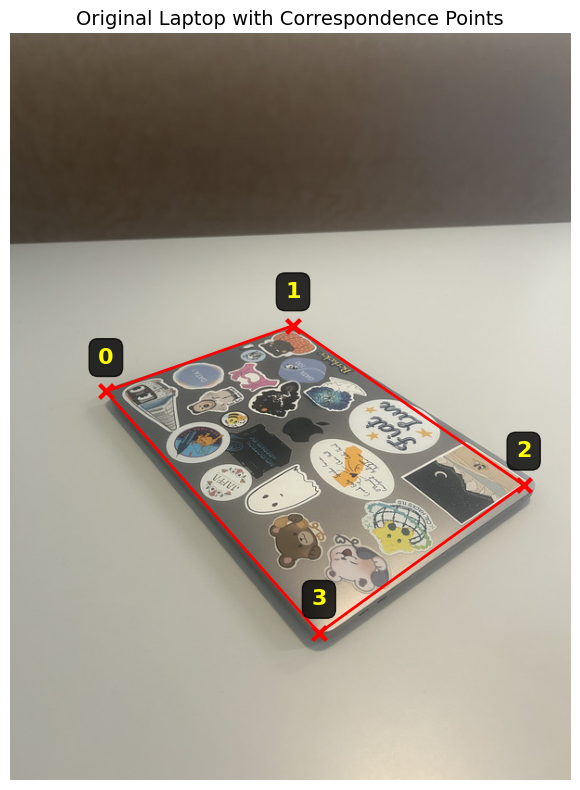

In [57]:
# Load laptop image and correspondences
with open('rectify_laptop.json', 'r') as f:
    rect_data = json.load(f)

laptop_img = io.imread('laptop.jpg')
im_pts_laptop = np.array(rect_data['im1Points'], dtype=np.float64)
rect_pts_laptop = np.array(rect_data['im2Points'], dtype=np.float64)

# Compute homography for rectification
H_laptop = computeH(im_pts_laptop, rect_pts_laptop, normalize=True)

# Show original with marked corners
fig, ax = plt.subplots(1, 1, figsize=(10, 8))
ax.imshow(laptop_img)
ax.scatter(im_pts_laptop[:, 0], im_pts_laptop[:, 1], c='red', s=100, marker='x', linewidths=3)
for i, (x, y) in enumerate(im_pts_laptop):
    ax.text(x, y-30, str(i), color='yellow', fontsize=16, ha='center', weight='bold',
           bbox=dict(boxstyle='round,pad=0.4', facecolor='black', alpha=0.8))
corners_loop = np.vstack([im_pts_laptop, im_pts_laptop[0]])
ax.plot(corners_loop[:, 0], corners_loop[:, 1], 'r-', linewidth=2)
ax.set_title('Original Laptop with Correspondence Points', fontsize=14)
ax.axis('off')
plt.tight_layout()
plt.savefig('laptop_original_marked.jpg', dpi=150, bbox_inches='tight')
plt.show()



Rectifying laptop image...
Nearest Neighbor:
  - Time: 22.714 seconds
  - Output shape: (6981, 10312, 3)

Bilinear Interpolation:
  - Time: 103.063 seconds
  - Output shape: (6981, 10312, 3)

Speed comparison: Bilinear is 4.54x slower


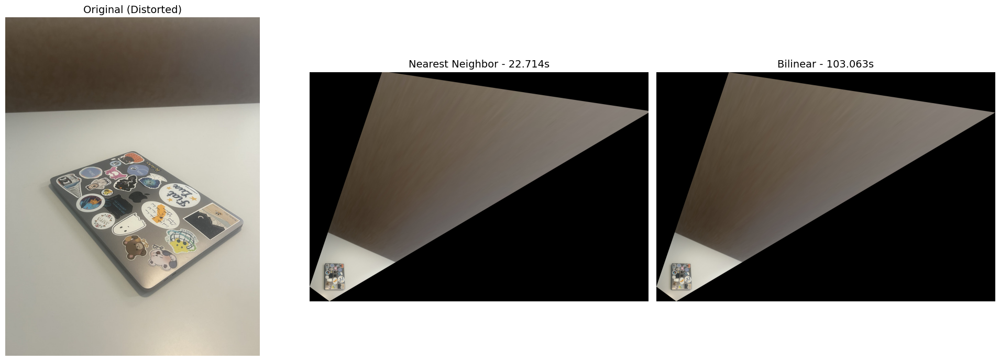

In [58]:
# Rectify laptop using both interpolation methods
print("\nRectifying laptop image...")

# Nearest Neighbor
start = time.time()
laptop_rect_nn, alpha_nn, offset_nn = warpImageNearestNeighbor(laptop_img, H_laptop)
time_nn_laptop = time.time() - start

# Bilinear
start = time.time()
laptop_rect_bil, alpha_bil, offset_bil = warpImageBilinear(laptop_img, H_laptop)
time_bil_laptop = time.time() - start

print(f"Nearest Neighbor:")
print(f"  - Time: {time_nn_laptop:.3f} seconds")
print(f"  - Output shape: {laptop_rect_nn.shape}")
print(f"\nBilinear Interpolation:")
print(f"  - Time: {time_bil_laptop:.3f} seconds")
print(f"  - Output shape: {laptop_rect_bil.shape}")
print(f"\nSpeed comparison: Bilinear is {time_bil_laptop/time_nn_laptop:.2f}x slower")

# Display results
fig, axes = plt.subplots(1, 3, figsize=(20, 7))

axes[0].imshow(laptop_img)
axes[0].set_title('Original (Distorted)', fontsize=14)
axes[0].axis('off')

axes[1].imshow(laptop_rect_nn)
axes[1].set_title(f'Nearest Neighbor - {time_nn_laptop:.3f}s', fontsize=14)
axes[1].axis('off')

axes[2].imshow(laptop_rect_bil)
axes[2].set_title(f'Bilinear - {time_bil_laptop:.3f}s', fontsize=14)
axes[2].axis('off')

plt.tight_layout()
plt.savefig('laptop_rectified_comparison.jpg', dpi=150, bbox_inches='tight')
plt.show()


Zoomed comparison for quality:


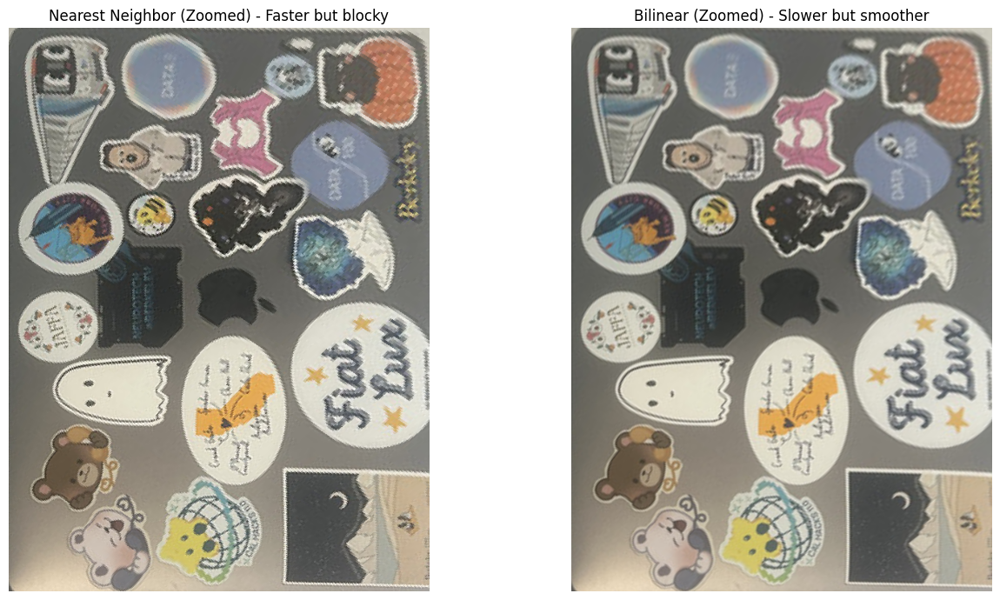

In [59]:
# I couldn't see the laptop so i copped and thus zoomed in lol 
print("Zoomed comparison for quality:")

# Use the target rectangle coordinates to crop the actual laptop screen
# Adjust for the offset returned by warping
rect_min_x = int(np.floor(rect_pts_laptop[:, 0].min()))
rect_max_x = int(np.ceil(rect_pts_laptop[:, 0].max()))
rect_min_y = int(np.floor(rect_pts_laptop[:, 1].min()))
rect_max_y = int(np.ceil(rect_pts_laptop[:, 1].max()))

# Adjust for the offset from warping
crop_x = rect_min_x - offset_nn[0]
crop_y = rect_min_y - offset_nn[1]
crop_w = rect_max_x - rect_min_x
crop_h = rect_max_y - rect_min_y

# Ensure crop is within bounds
crop_x = max(0, crop_x)
crop_y = max(0, crop_y)
crop_w = min(crop_w, laptop_rect_nn.shape[1] - crop_x)
crop_h = min(crop_h, laptop_rect_nn.shape[0] - crop_y)

fig, axes = plt.subplots(1, 2, figsize=(14, 7))

axes[0].imshow(laptop_rect_nn[crop_y:crop_y+crop_h, crop_x:crop_x+crop_w])
axes[0].set_title('Nearest Neighbor (Zoomed) - Faster but blocky', fontsize=12)
axes[0].axis('off')

axes[1].imshow(laptop_rect_bil[crop_y:crop_y+crop_h, crop_x:crop_x+crop_w])
axes[1].set_title('Bilinear (Zoomed) - Slower but smoother', fontsize=12)
axes[1].axis('off')

plt.tight_layout()
plt.savefig('laptop_rectified_zoomed.jpg', dpi=150, bbox_inches='tight')
plt.show()




### Rectification Example 2: Folder


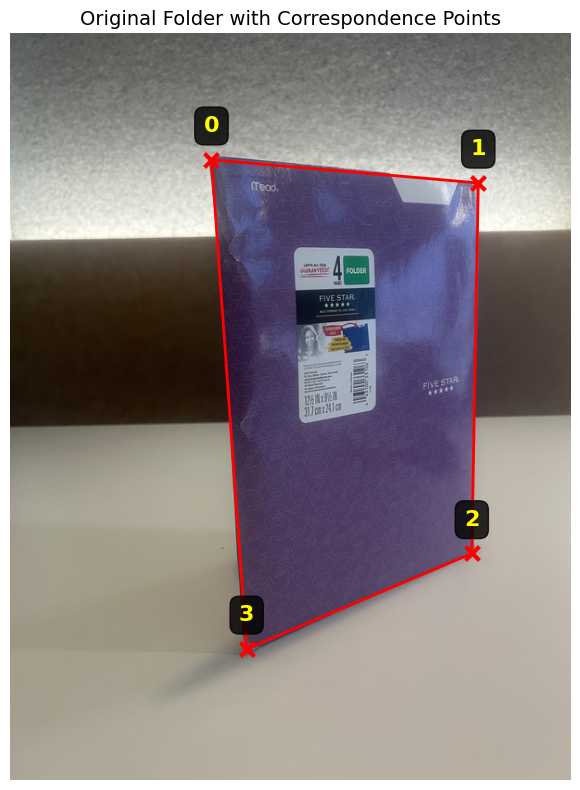

In [60]:
with open('rectify_folder.json', 'r') as f:
    rect_data = json.load(f)

folder_img = io.imread('folder.jpg')
im_pts_folder = np.array(rect_data['im1Points'], dtype=np.float64)
rect_pts_folder = np.array(rect_data['im2Points'], dtype=np.float64)

# Compute homography
H_folder = computeH(im_pts_folder, rect_pts_folder, normalize=True)

# Show original with marked corners
fig, ax = plt.subplots(1, 1, figsize=(10, 8))
ax.imshow(folder_img)
ax.scatter(im_pts_folder[:, 0], im_pts_folder[:, 1], c='red', s=100, marker='x', linewidths=3)
for i, (x, y) in enumerate(im_pts_folder):
    ax.text(x, y-30, str(i), color='yellow', fontsize=16, ha='center', weight='bold',
           bbox=dict(boxstyle='round,pad=0.4', facecolor='black', alpha=0.8))
corners_loop = np.vstack([im_pts_folder, im_pts_folder[0]])
ax.plot(corners_loop[:, 0], corners_loop[:, 1], 'r-', linewidth=2)
ax.set_title('Original Folder with Correspondence Points', fontsize=14)
ax.axis('off')
plt.tight_layout()
plt.savefig('folder_original_marked.jpg', dpi=150, bbox_inches='tight')
plt.show()



Rectifying folder image...
Nearest Neighbor:
  - Time: 0.110 seconds
  - Output shape: (1383, 923, 3)

Bilinear Interpolation:
  - Time: 0.306 seconds
  - Output shape: (1383, 923, 3)

Speed comparison: Bilinear is 2.78x slower


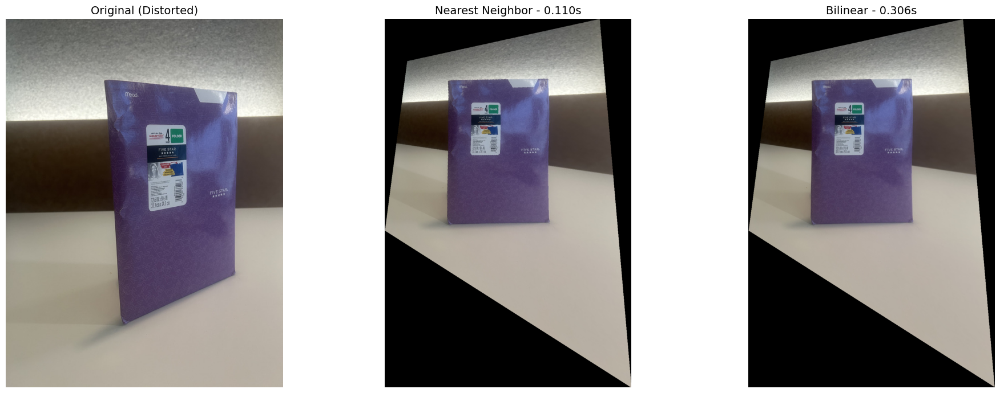

In [61]:
# Rectify folder using both interpolation methods
print("\nRectifying folder image...")

# Nearest Neighbor
start = time.time()
folder_rect_nn, alpha_nn, offset_nn = warpImageNearestNeighbor(folder_img, H_folder)
time_nn_folder = time.time() - start

# Bilinear
start = time.time()
folder_rect_bil, alpha_bil, offset_bil = warpImageBilinear(folder_img, H_folder)
time_bil_folder = time.time() - start

print(f"Nearest Neighbor:")
print(f"  - Time: {time_nn_folder:.3f} seconds")
print(f"  - Output shape: {folder_rect_nn.shape}")
print(f"\nBilinear Interpolation:")
print(f"  - Time: {time_bil_folder:.3f} seconds")
print(f"  - Output shape: {folder_rect_bil.shape}")
print(f"\nSpeed comparison: Bilinear is {time_bil_folder/time_nn_folder:.2f}x slower")

fig, axes = plt.subplots(1, 3, figsize=(20, 7))

axes[0].imshow(folder_img)
axes[0].set_title('Original (Distorted)', fontsize=14)
axes[0].axis('off')

axes[1].imshow(folder_rect_nn)
axes[1].set_title(f'Nearest Neighbor - {time_nn_folder:.3f}s', fontsize=14)
axes[1].axis('off')

axes[2].imshow(folder_rect_bil)
axes[2].set_title(f'Bilinear - {time_bil_folder:.3f}s', fontsize=14)
axes[2].axis('off')

plt.tight_layout()
plt.savefig('folder_rectified_comparison.jpg', dpi=150, bbox_inches='tight')
plt.show()

Zoomed comparison for quality:
Cropping region: x=237:613, y=224:767


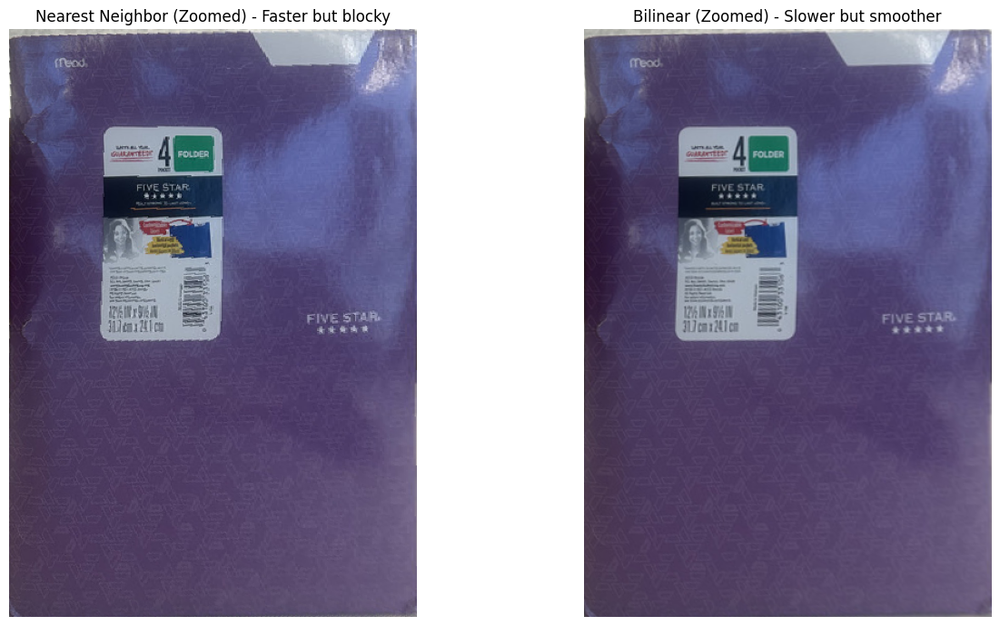

In [62]:
# Zoomed comparison because i couldn't see it properly before lol
print("Zoomed comparison for quality:")

# Adjust for the offset returned by warping
rect_min_x = int(np.floor(rect_pts_folder[:, 0].min()))
rect_max_x = int(np.ceil(rect_pts_folder[:, 0].max()))
rect_min_y = int(np.floor(rect_pts_folder[:, 1].min()))
rect_max_y = int(np.ceil(rect_pts_folder[:, 1].max()))

# Adjust for the offset from warping
crop_x = rect_min_x - offset_nn[0]
crop_y = rect_min_y - offset_nn[1]
crop_w = rect_max_x - rect_min_x
crop_h = rect_max_y - rect_min_y

# Ensure crop is within bounds
crop_x = max(0, crop_x)
crop_y = max(0, crop_y)
crop_w = min(crop_w, folder_rect_nn.shape[1] - crop_x)
crop_h = min(crop_h, folder_rect_nn.shape[0] - crop_y)

print(f"Cropping region: x={crop_x}:{crop_x+crop_w}, y={crop_y}:{crop_y+crop_h}")

fig, axes = plt.subplots(1, 2, figsize=(14, 7))

axes[0].imshow(folder_rect_nn[crop_y:crop_y+crop_h, crop_x:crop_x+crop_w])
axes[0].set_title('Nearest Neighbor (Zoomed) - Faster but blocky', fontsize=12)
axes[0].axis('off')

axes[1].imshow(folder_rect_bil[crop_y:crop_y+crop_h, crop_x:crop_x+crop_w])
axes[1].set_title('Bilinear (Zoomed) - Slower but smoother', fontsize=12)
axes[1].axis('off')

plt.tight_layout()
plt.savefig('folder_rectified_zoomed.jpg', dpi=150, bbox_inches='tight')
plt.show()


### A.4: Blend Images into Mosaics

In [63]:
def build_mosaic(images, homographies, interp='bilinear'):
    # get the final canvas bounds by projecting each image's corners with its H
    min_x = +1e18; min_y = +1e18
    max_x = -1e18; max_y = -1e18
    for im, H in zip(images, homographies):
        if im.ndim == 2: h, w, = im.shape
        else:            h, w, _ = im.shape
        corners = np.array([[0,   0,   w-1, w-1],
                            [0,   h-1, 0,   h-1],
                            [1,   1,   1,   1   ]], dtype=np.float64)
        proj = H @ corners
        proj /= np.maximum(proj[2:3, :], 1e-12)
        xs, ys = proj[0], proj[1]
        min_x = min(min_x, np.floor(xs.min()))
        max_x = max(max_x, np.ceil(xs.max()))
        min_y = min(min_y, np.floor(ys.min()))
        max_y = max(max_y, np.ceil(ys.max()))
    min_x = int(min_x); max_x = int(max_x)
    min_y = int(min_y); max_y = int(max_y)

    Hc = max_y - min_y + 1
    Wc = max_x - min_x + 1

    acc = np.zeros((Hc, Wc, 3), dtype=np.float32)
    wgt = np.zeros((Hc, Wc, 1), dtype=np.float32)

    # warp each image into its own tight bbox, then paste into global canvas at right offset
    for im, H in zip(images, homographies):
        if interp == 'nearest':
            warped, alpha, (ox, oy) = warpImageNearestNeighbor(im, H)
        else:
            warped, alpha, (ox, oy) = warpImageBilinear(im, H)

        # ensure 3 channels
        if warped.ndim == 2:
            warped = warped[..., None]
        if warped.shape[2] == 1:
            warped = np.repeat(warped, 3, axis=2)

        # place into global canvas
        gx = ox - min_x
        gy = oy - min_y
        h, w = warped.shape[:2]

        A = alpha.astype(np.float32)[..., None]  # (h,w,1)
        acc[gy:gy+h, gx:gx+w, :] += (warped.astype(np.float32) * A)
        wgt[gy:gy+h, gx:gx+w, :] += A

    # normalize
    wgt = np.clip(wgt, 1e-8, None)
    out = acc / wgt
    out = np.clip(out, 0.0, 1.0).astype(np.float32)
    return out

### Mosaic #1: My Rooftop 

  Left: (806, 605, 3)
  Center: (806, 605, 3)
  Right: (806, 605, 3)

Building mosaic...
time was 1.62s, shape: (1377, 1887, 3)


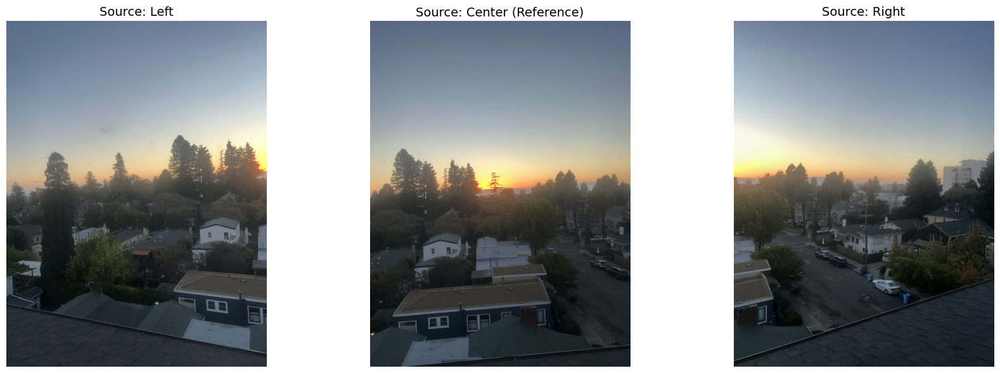

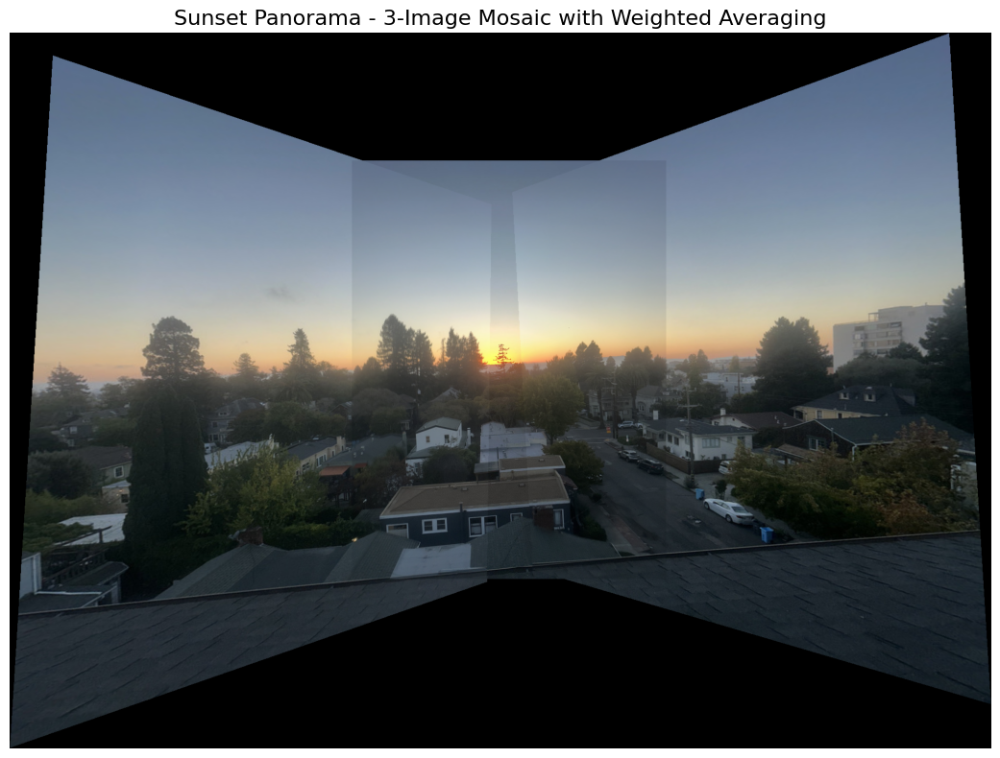

In [64]:
im_left2 = io.imread('left2.jpg')
im_center2 = io.imread('center2.jpg')
im_right2 = io.imread('right2.jpg')

print(f"  Left: {im_left2.shape}")
print(f"  Center: {im_center2.shape}")
print(f"  Right: {im_right2.shape}")

#i need 2 correspondence mappings for a 3 image pano
with open('sunset_left_center.json', 'r') as f:
    corr_lc = json.load(f)
pts_left = np.array(corr_lc['im1Points'], dtype=np.float64)
pts_center_lc = np.array(corr_lc['im2Points'], dtype=np.float64)
H_lc = computeH(pts_left, pts_center_lc)

with open('sunset_center_right.json', 'r') as f:
    corr_cr = json.load(f)
pts_center_cr = np.array(corr_cr['im1Points'], dtype=np.float64)
pts_right = np.array(corr_cr['im2Points'], dtype=np.float64)
H_cr = computeH(pts_center_cr, pts_right)

images_sunset = [im_left2, im_center2, im_right2]
# make a combo H matrix
homographies_sunset = [
    H_lc,                    # Warp left to center
    np.eye(3),               # Center is reference
    np.linalg.inv(H_cr)      # Warp right to center
]

# Build mosaic
print("\nBuilding mosaic...")
start = time.time()
mosaic_sunset = build_mosaic(images_sunset, homographies_sunset, interp='bilinear')
mosaic_time = time.time() - start
print(f"time was {mosaic_time:.2f}s, shape: {mosaic_sunset.shape}")

# Display source images
fig, axes = plt.subplots(1, 3, figsize=(18, 6))
axes[0].imshow(im_left2)
axes[0].set_title('Source: Left', fontsize=14)
axes[0].axis('off')

axes[1].imshow(im_center2)
axes[1].set_title('Source: Center (Reference)', fontsize=14)
axes[1].axis('off')

axes[2].imshow(im_right2)
axes[2].set_title('Source: Right', fontsize=14)
axes[2].axis('off')

plt.tight_layout()
plt.savefig('mosaic_sunset_sources.jpg', dpi=150, bbox_inches='tight')
plt.show()

fig, ax = plt.subplots(1, 1, figsize=(20, 8))
ax.imshow(mosaic_sunset)
ax.set_title('Sunset Panorama - 3-Image Mosaic with Weighted Averaging', fontsize=16)
ax.axis('off')
plt.tight_layout()
plt.savefig('mosaic_sunset_panorama.jpg', dpi=150, bbox_inches='tight')
plt.show()

### Alternative Blending: Distance-Based Feathering

Instead of simple alpha channel (0 or 1), use distance transform for smooth feathering.


In [65]:
from scipy.ndimage import distance_transform_edt

def build_mosaic_feathered(images, homographies, interp='bilinear'):
    """
    Build mosaic with distance-based feathering for smoother blends.
    Alpha = 1 at center, falls off linearly to 0 at edges using distance transform.
    """
    # bound 
    min_x = +1e18; min_y = +1e18
    max_x = -1e18; max_y = -1e18
    for im, H in zip(images, homographies):
        if im.ndim == 2: h, w = im.shape
        else:            h, w, _ = im.shape
        corners = np.array([[0,   0,   w-1, w-1],
                            [0,   h-1, 0,   h-1],
                            [1,   1,   1,   1   ]], dtype=np.float64)
        proj = H @ corners
        proj /= np.maximum(proj[2:3, :], 1e-12)
        xs, ys = proj[0], proj[1]
        min_x = min(min_x, np.floor(xs.min()))
        max_x = max(max_x, np.ceil(xs.max()))
        min_y = min(min_y, np.floor(ys.min()))
        max_y = max(max_y, np.ceil(ys.max()))
    
    min_x = int(min_x); max_x = int(max_x)
    min_y = int(min_y); max_y = int(max_y)
    Hc = max_y - min_y + 1
    Wc = max_x - min_x + 1

    acc = np.zeros((Hc, Wc, 3), dtype=np.float32)
    wgt = np.zeros((Hc, Wc, 1), dtype=np.float32)

    # warp with the distance based from b4
    for im, H in zip(images, homographies):
        if interp == 'nearest':
            warped, alpha, (ox, oy) = warpImageNearestNeighbor(im, H)
        else:
            warped, alpha, (ox, oy) = warpImageBilinear(im, H)

        # create distance-based alpha (feathering)
        # distance from edges is higher in center, 0 at edges
        dist = distance_transform_edt(alpha)
        
        # normalize
        if dist.max() > 0:
            alpha_feathered = dist / dist.max()
        else:
            alpha_feathered = alpha
        
        if warped.ndim == 2:
            warped = warped[..., None]
        if warped.shape[2] == 1:
            warped = np.repeat(warped, 3, axis=2)

        # place it now
        gx = ox - min_x
        gy = oy - min_y
        h, w = warped.shape[:2]

        A = alpha_feathered.astype(np.float32)[..., None]  # (h,w,1)
        acc[gy:gy+h, gx:gx+w, :] += (warped.astype(np.float32) * A)
        wgt[gy:gy+h, gx:gx+w, :] += A

    # normalize again womp womp
    wgt = np.clip(wgt, 1e-8, None)
    out = acc / wgt
    out = np.clip(out, 0.0, 1.0).astype(np.float32)
    return out


Building mosaic with distance-based feathering...
time was 0.95s, shape: (1377, 1887, 3)


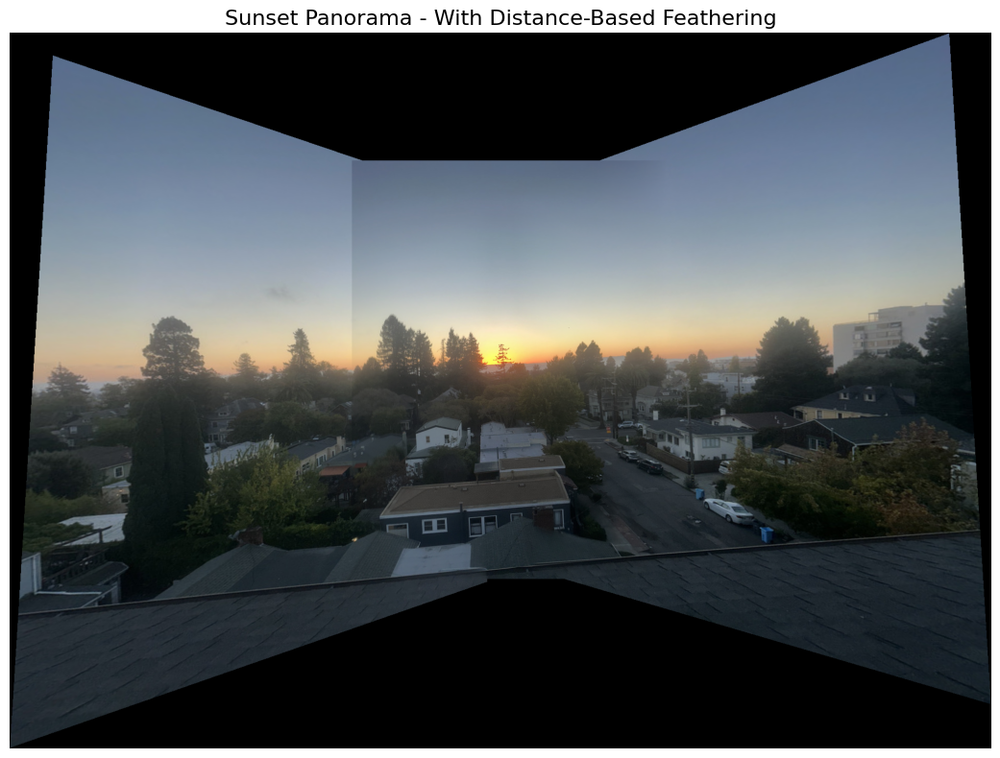

In [66]:
# Build mosaic with feathering
print("\nBuilding mosaic with distance-based feathering...")
start = time.time()
mosaic_sunset_feathered = build_mosaic_feathered(images_sunset, homographies_sunset, interp='bilinear')
feather_time = time.time() - start
print(f"time was {feather_time:.2f}s, shape: {mosaic_sunset_feathered.shape}")

# Display feathered panorama
fig, ax = plt.subplots(1, 1, figsize=(20, 8))
ax.imshow(mosaic_sunset_feathered)
ax.set_title('Sunset Panorama - With Distance-Based Feathering', fontsize=16)
ax.axis('off')
plt.tight_layout()
plt.savefig('mosaic_sunset_feathered.jpg', dpi=150, bbox_inches='tight')
plt.show()


### Alternative Blending: Laplacian Pyramid (Multi-Resolution Blending)

Trying to soften the edge in this picture on the left side even more than feathering. 


In [67]:
# Import Laplacian stack functions from proj2 implementation
from scipy.signal import convolve2d as conv2d
import cv2

def create_2d_gaussian(size, sigma):
    g1d = cv2.getGaussianKernel(size, sigma)
    return np.outer(g1d, g1d.T)

def _odd_from_sigma(sigma):
    k = int(6 * float(sigma))
    if k % 2 == 0: k += 1
    return max(k, 3)

def low_pass_filter(image, gaussian_filter):
    if image.ndim == 2:
        return conv2d(image, gaussian_filter, mode='same', boundary='symm')
    outs = [conv2d(image[..., c], gaussian_filter, mode='same', boundary='symm')
            for c in range(image.shape[2])]
    return np.stack(outs, axis=2)

def gaussian_stack(image, levels=5, sigma=2.0):
    k = _odd_from_sigma(sigma)
    gker = create_2d_gaussian(k, sigma).astype(np.float32)
    G = [image.astype(np.float32)]
    for _ in range(1, levels):
        G.append(low_pass_filter(G[-1], gker))
    return G

def laplacian_stack(gauss_stack):
    L = []
    for i in range(len(gauss_stack)-1):
        L.append(gauss_stack[i] - gauss_stack[i+1])
    L.append(gauss_stack[-1])  # Last level is the most blurred Gaussian
    return L

def reconstruct_from_laplacian(L):
    rec = np.zeros_like(L[0], dtype=np.float32)
    for Li in L:
        rec = rec + Li
    return np.clip(rec, 0.0, 1.0)

def build_mosaic_laplacian(images, homographies, levels=2, sigma=2.0, interp='bilinear'):
    # Compute canvas bounds
    min_x = +1e18; min_y = +1e18
    max_x = -1e18; max_y = -1e18
    for im, H in zip(images, homographies):
        if im.ndim == 2: h, w = im.shape
        else:            h, w, _ = im.shape
        corners = np.array([[0,   0,   w-1, w-1],
                            [0,   h-1, 0,   h-1],
                            [1,   1,   1,   1   ]], dtype=np.float64)
        proj = H @ corners
        proj /= np.maximum(proj[2:3, :], 1e-12)
        xs, ys = proj[0], proj[1]
        min_x = min(min_x, np.floor(xs.min()))
        max_x = max(max_x, np.ceil(xs.max()))
        min_y = min(min_y, np.floor(ys.min()))
        max_y = max(max_y, np.ceil(ys.max()))
    
    min_x = int(min_x); max_x = int(max_x)
    min_y = int(min_y); max_y = int(max_y)
    Hc = max_y - min_y + 1
    Wc = max_x - min_x + 1

    # Warp images and build Laplacian stacks for each
    warped_laplacian_stacks = []
    alpha_gaussian_stacks = []
    
    for im, H in zip(images, homographies):
        # Warp image
        if interp == 'nearest':
            warped, alpha, (ox, oy) = warpImageNearestNeighbor(im, H)
        else:
            warped, alpha, (ox, oy) = warpImageBilinear(im, H)
        
        # Ensure 3 channels
        if warped.ndim == 2:
            warped = warped[..., None]
        if warped.shape[2] == 1:
            warped = np.repeat(warped, 3, axis=2)
        
        # Create full canvas for this image
        canvas = np.zeros((Hc, Wc, 3), dtype=np.float32)
        alpha_canvas = np.zeros((Hc, Wc), dtype=np.float32)
        
        gx = ox - min_x
        gy = oy - min_y
        h, w = warped.shape[:2]
        
        canvas[gy:gy+h, gx:gx+w, :] = warped.astype(np.float32)
        
        # Use distance-based alpha for smoother blending
        dist = distance_transform_edt(alpha)
        if dist.max() > 0:
            alpha_feathered = dist / dist.max()
        else:
            alpha_feathered = alpha
        alpha_canvas[gy:gy+h, gx:gx+w] = alpha_feathered.astype(np.float32)
        
        # Build stacks (using proj2 implementation)
        G = gaussian_stack(canvas, levels=levels, sigma=sigma)
        L = laplacian_stack(G)
        warped_laplacian_stacks.append(L)
        
        # Gaussian stack for alpha mask
        GM = gaussian_stack(alpha_canvas, levels=levels, sigma=sigma)
        alpha_gaussian_stacks.append(GM)
    
    # Blend at each level (like oraple)
    blended_laplacian = []
    for level in range(levels):
        # Weighted combination at this frequency level
        acc = np.zeros_like(warped_laplacian_stacks[0][level])
        wgt = np.zeros(warped_laplacian_stacks[0][level].shape[:2] + (1,), dtype=np.float32)
        
        for i in range(len(images)):
            lap = warped_laplacian_stacks[i][level]
            alp = alpha_gaussian_stacks[i][level]
            
            if lap.ndim == 2:
                lap = lap[..., None]
            if lap.shape[2] == 1:
                lap = np.repeat(lap, 3, axis=2)
            
            A = alp.astype(np.float32)[..., None]
            acc += lap * A
            wgt += A
        
        wgt = np.clip(wgt, 1e-8, None)
        blended = acc / wgt
        blended_laplacian.append(blended)
    
    # Reconstruct from Laplacian stack
    result = reconstruct_from_laplacian(blended_laplacian)
    return result


Building sunset mosaic with Laplacian stack blending...
time was 17.68s, shape: (1377, 1887, 3)


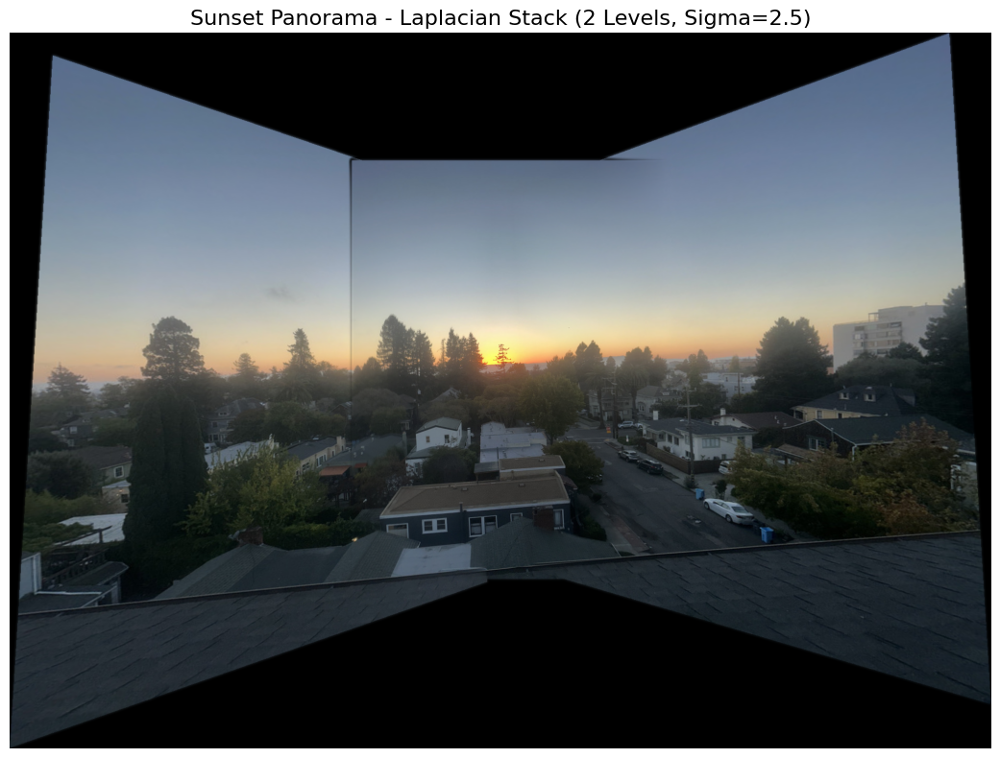

In [68]:
# Apply Laplacian stack blending to sunset panorama
print("\nBuilding sunset mosaic with Laplacian stack blending...")
start = time.time()
mosaic_sunset_laplacian = build_mosaic_laplacian(images_sunset, homographies_sunset, 
                                                   levels=2, sigma=2.5, interp='bilinear')
laplacian_time = time.time() - start
print(f"time was {laplacian_time:.2f}s, shape: {mosaic_sunset_laplacian.shape}")

# Display result
fig, ax = plt.subplots(1, 1, figsize=(20, 8))
ax.imshow(mosaic_sunset_laplacian)
ax.set_title('Sunset Panorama - Laplacian Stack (2 Levels, Sigma=2.5)', fontsize=16)
ax.axis('off')
plt.tight_layout()
plt.savefig('mosaic_sunset_laplacian.jpg', dpi=150, bbox_inches='tight')
plt.show()


Comparing All Three Blending Methods (Sunset Panorama):


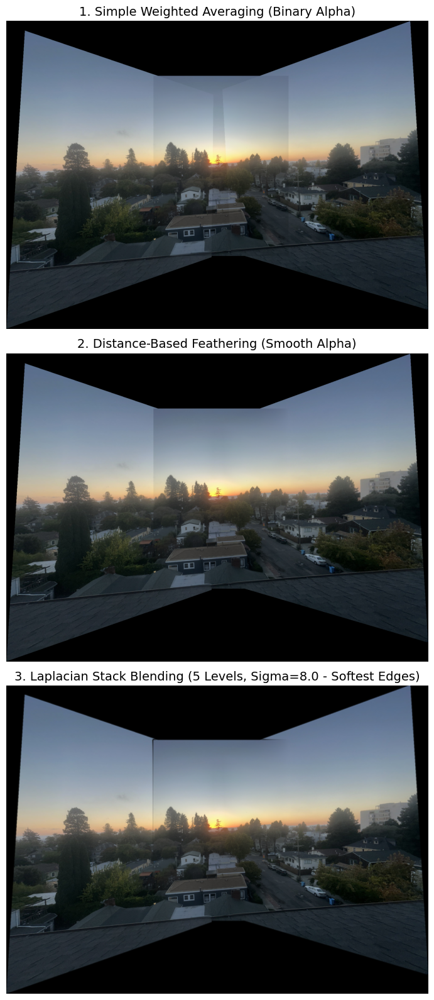


Timing Comparison:
  Simple averaging:     1.62s
  Distance feathering:  0.95s (0.59x)
  Laplacian stack:      17.68s (10.94x)


In [ ]:
# Compare all three blending methods for sunset panorama
print("\nComparing All Three Blending Methods (Sunset Panorama):")

fig, axes = plt.subplots(3, 1, figsize=(20, 16))

axes[0].imshow(mosaic_sunset)
axes[0].set_title('1. Simple Weighted Averaging (Binary Alpha)', fontsize=14)
axes[0].axis('off')

axes[1].imshow(mosaic_sunset_feathered)
axes[1].set_title('2. Distance-Based Feathering (Smooth Alpha)', fontsize=14)
axes[1].axis('off')

axes[2].imshow(mosaic_sunset_laplacian)
axes[2].set_title('3. Laplacian Stack Blending (2 Levels, Sigma=2.5)', fontsize=14)
axes[2].axis('off')

plt.tight_layout()
plt.savefig('mosaic_sunset_all_methods_comparison.jpg', dpi=150, bbox_inches='tight')
plt.show()

print(f"\nTiming Comparison:")
print(f"  Simple averaging:     {mosaic_time:.2f}s")
print(f"  Distance feathering:  {feather_time:.2f}s ({feather_time/mosaic_time:.2f}x)")
print(f"  Laplacian stack:      {laplacian_time:.2f}s ({laplacian_time/mosaic_time:.2f}x)")


### Mosaic 2: Statue Panorama

Creating panorama from statue near the faculty glade :P (left-center-right).


  Left: (806, 605, 3)
  Center: (806, 605, 3)
  Right: (806, 605, 3)

Computed H_lc (left -> center) from 26 correspondences
Computed H_cr (center -> right) from 26 correspondences


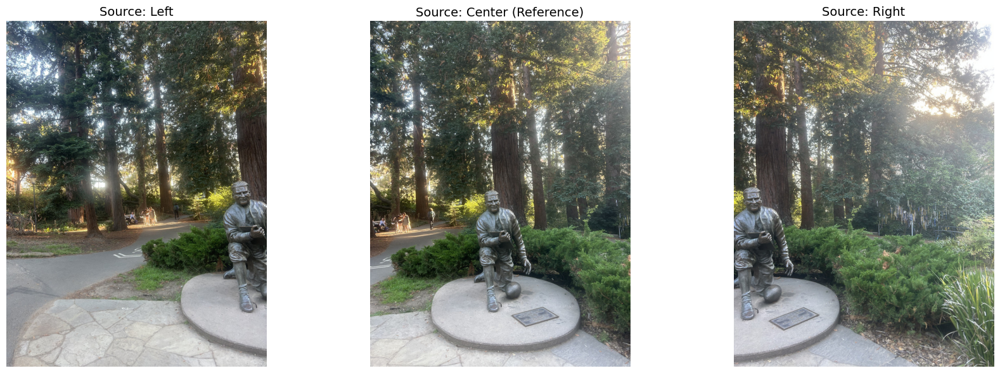

In [70]:
im_left_statue = io.imread('left_statue.jpg')
im_center_statue = io.imread('center_statue.jpg')
im_right_statue = io.imread('right_statue.jpg')

print(f"  Left: {im_left_statue.shape}")
print(f"  Center: {im_center_statue.shape}")
print(f"  Right: {im_right_statue.shape}")


with open('statue_left_center.json', 'r') as f:
    corr_lc = json.load(f)
pts_left_s = np.array(corr_lc['im1Points'], dtype=np.float64)
pts_center_lc_s = np.array(corr_lc['im2Points'], dtype=np.float64)
H_lc_s = computeH(pts_left_s, pts_center_lc_s)
print(f"\nComputed H_lc (left -> center) from {len(pts_left_s)} correspondences")

with open('statue_center_right.json', 'r') as f:
    corr_cr = json.load(f)
pts_center_cr_s = np.array(corr_cr['im1Points'], dtype=np.float64)
pts_right_s = np.array(corr_cr['im2Points'], dtype=np.float64)
H_cr_s = computeH(pts_center_cr_s, pts_right_s)
print(f"Computed H_cr (center -> right) from {len(pts_center_cr_s)} correspondences")

# combo H matrix
images_statue = [im_left_statue, im_center_statue, im_right_statue]
homographies_statue = [
    H_lc_s,                   
    np.eye(3),              
    np.linalg.inv(H_cr_s)
]

fig, axes = plt.subplots(1, 3, figsize=(18, 6))
axes[0].imshow(im_left_statue)
axes[0].set_title('Source: Left', fontsize=14)
axes[0].axis('off')

axes[1].imshow(im_center_statue)
axes[1].set_title('Source: Center (Reference)', fontsize=14)
axes[1].axis('off')

axes[2].imshow(im_right_statue)
axes[2].set_title('Source: Right', fontsize=14)
axes[2].axis('off')

plt.tight_layout()
plt.savefig('mosaic_statue_sources.jpg', dpi=150, bbox_inches='tight')
plt.show()



Building mosaic with simple weighted averaging...
time was 0.47s, shape: (1156, 1484, 3)


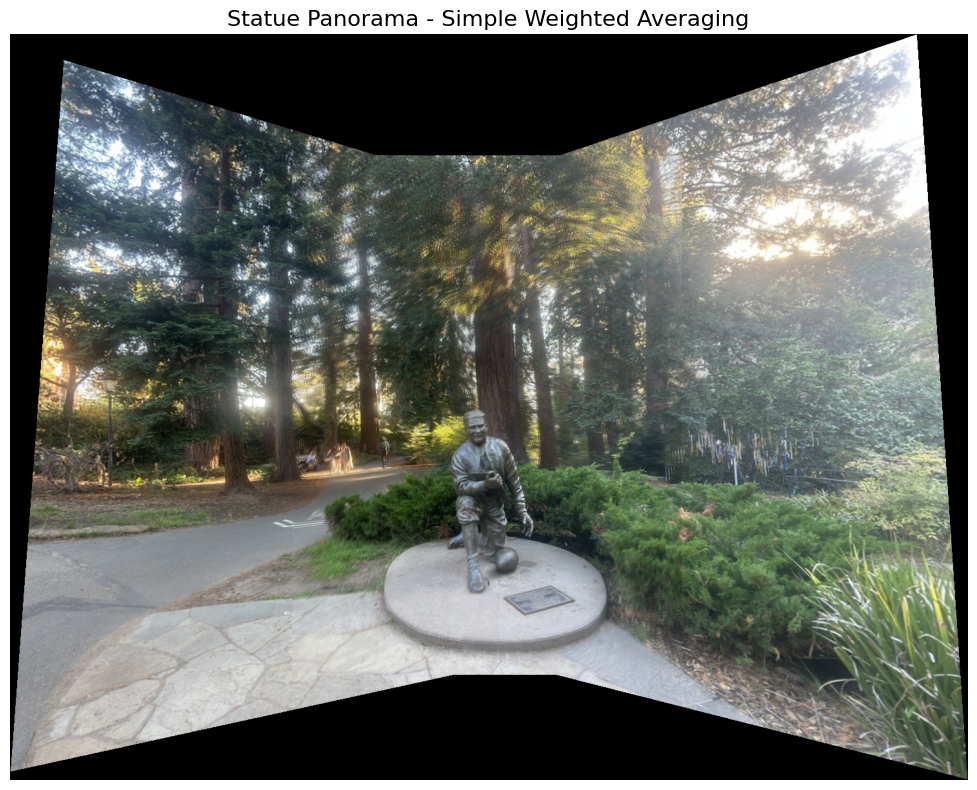

In [71]:
# Build statue mosaic with simple weighted averaging
print("\nBuilding mosaic with simple weighted averaging...")
start = time.time()
mosaic_statue = build_mosaic(images_statue, homographies_statue, interp='bilinear')
time_simple = time.time() - start
print(f"time was {time_simple:.2f}s, shape: {mosaic_statue.shape}")

fig, ax = plt.subplots(1, 1, figsize=(20, 8))
ax.imshow(mosaic_statue)
ax.set_title('Statue Panorama - Simple Weighted Averaging', fontsize=16)
ax.axis('off')
plt.tight_layout()
plt.savefig('mosaic_statue_simple.jpg', dpi=150, bbox_inches='tight')
plt.show()



Building mosaic with distance-based feathering...
 time was 0.80s, shape: (1156, 1484, 3)


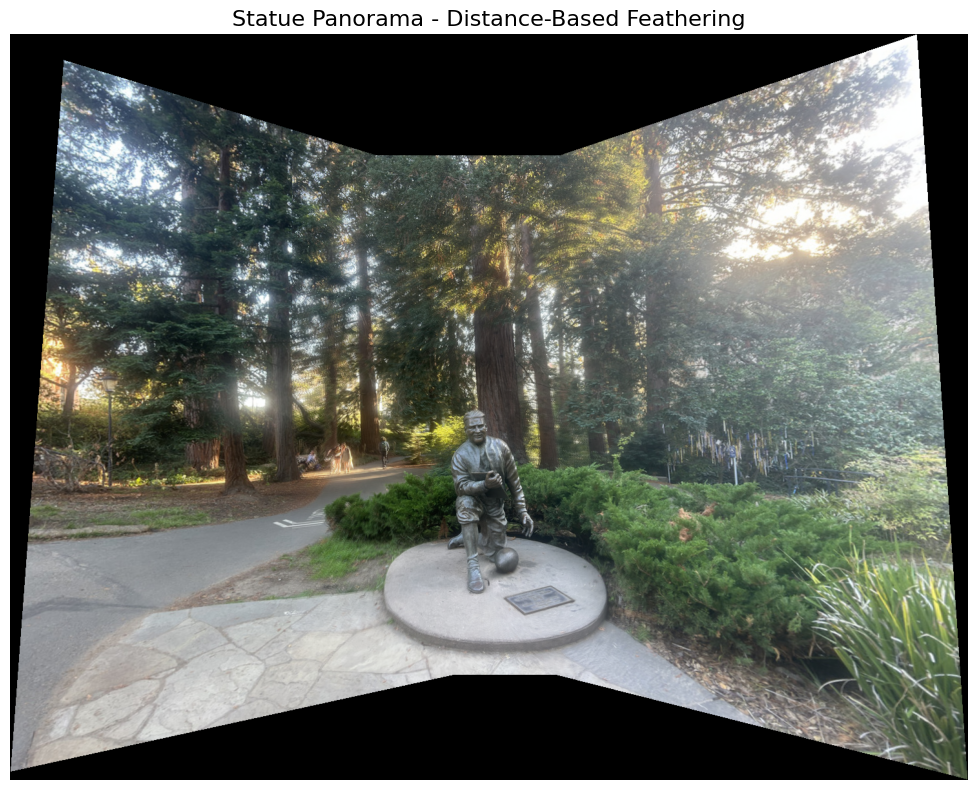

In [72]:
# Build statue mosaic with distance-based feathering
print("\nBuilding mosaic with distance-based feathering...")
start = time.time()
mosaic_statue_feathered = build_mosaic_feathered(images_statue, homographies_statue, interp='bilinear')
time_feathered = time.time() - start
print(f" time was {time_feathered:.2f}s, shape: {mosaic_statue_feathered.shape}")

# Display
fig, ax = plt.subplots(1, 1, figsize=(20, 8))
ax.imshow(mosaic_statue_feathered)
ax.set_title('Statue Panorama - Distance-Based Feathering', fontsize=16)
ax.axis('off')
plt.tight_layout()
plt.savefig('mosaic_statue_feathered.jpg', dpi=150, bbox_inches='tight')
plt.show()



Comparing Blending Methods (Statue Panorama):


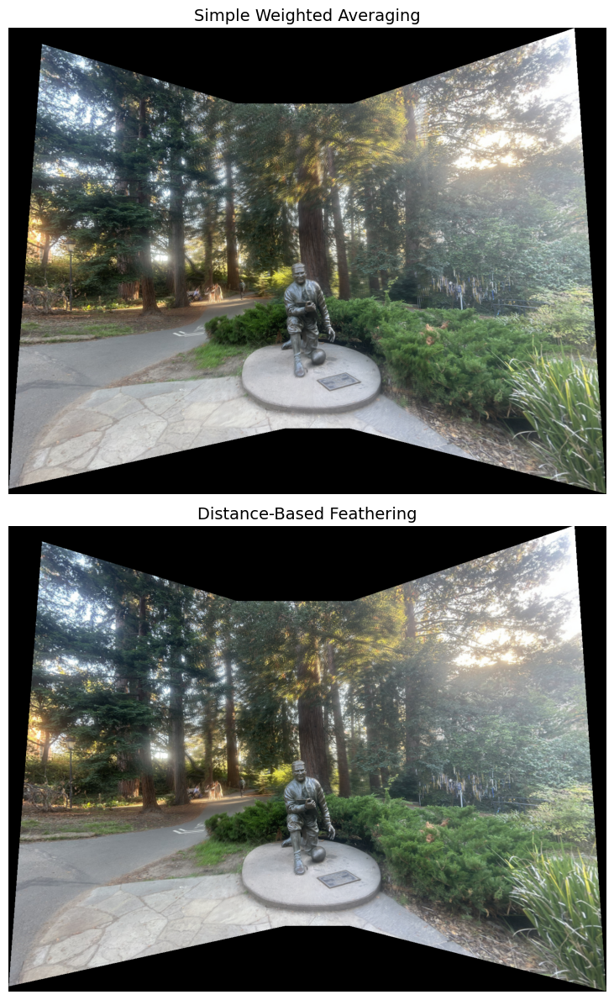


Timing:
  Simple averaging: 0.47s
  Feathering: 0.80s
  Overhead: 1.70x


In [73]:
# Compare blending methods for statue panorama
print("\nComparing Blending Methods (Statue Panorama):")

fig, axes = plt.subplots(2, 1, figsize=(20, 12))

axes[0].imshow(mosaic_statue)
axes[0].set_title('Simple Weighted Averaging', fontsize=14)
axes[0].axis('off')

axes[1].imshow(mosaic_statue_feathered)
axes[1].set_title('Distance-Based Feathering', fontsize=14)
axes[1].axis('off')

plt.tight_layout()
plt.savefig('mosaic_statue_comparison.jpg', dpi=150, bbox_inches='tight')
plt.show()

print(f"\nTiming:")
print(f"  Simple averaging: {time_simple:.2f}s")
print(f"  Feathering: {time_feathered:.2f}s")
print(f"  Overhead: {time_feathered/time_simple:.2f}x")


### Mosaic 3: Willard Park :) 

Creating mosaic from a2left and a2right images using correspondences from A.2.

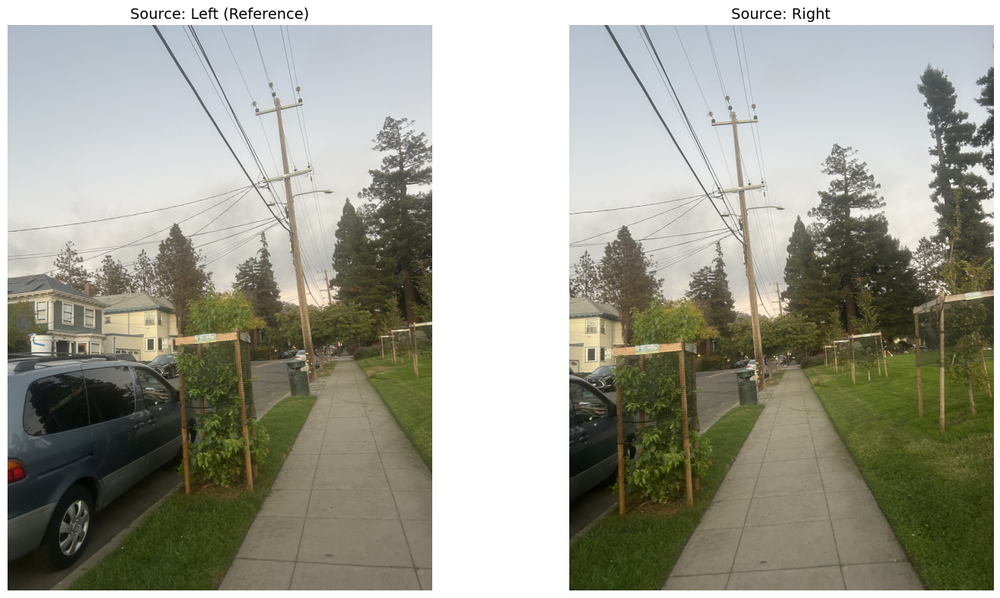

In [74]:
# Images already loaded in A.2: im1 (a2left), im2 (a2right)
# Correspondences already loaded: im1_pts, im2_pts

# Compute homography
H_a2 = computeH(im1_pts, im2_pts)

# keep left as reference, warp right
images_a2 = [im1, im2]
homographies_a2 = [
    np.eye(3),       
    np.linalg.inv(H_a2)
]

fig, axes = plt.subplots(1, 2, figsize=(16, 8))
axes[0].imshow(im1)
axes[0].set_title('Source: Left (Reference)', fontsize=14)
axes[0].axis('off')

axes[1].imshow(im2)
axes[1].set_title('Source: Right', fontsize=14)
axes[1].axis('off')

plt.tight_layout()
plt.savefig('mosaic_a2_sources.jpg', dpi=150, bbox_inches='tight')
plt.show()



Building mosaic with simple weighted averaging...
time was2.09s, shape: (2327, 2135, 3)


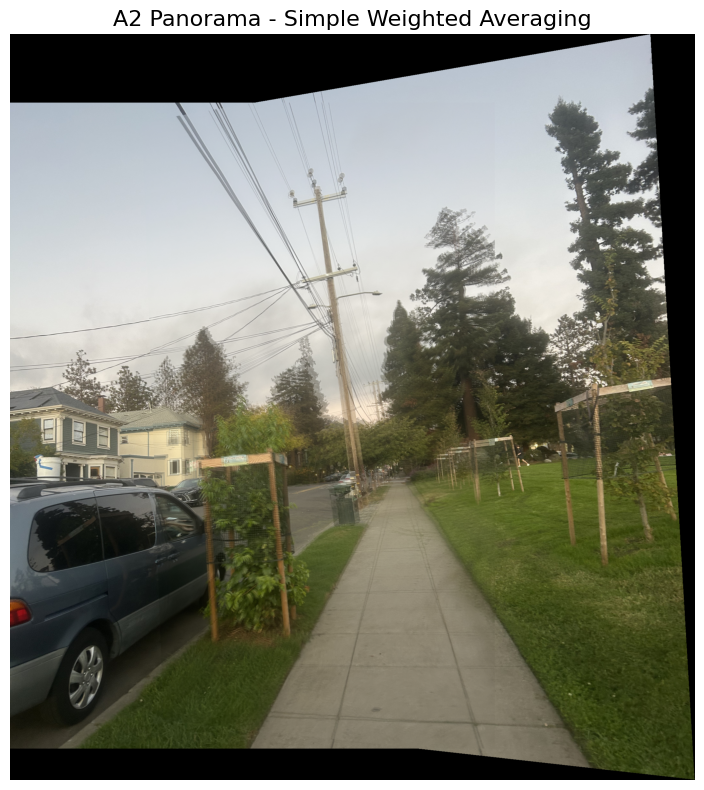

In [75]:
# Build a2 mosaic with simple weighted averaging
print("\nBuilding mosaic with simple weighted averaging...")
start = time.time()
mosaic_a2 = build_mosaic(images_a2, homographies_a2, interp='bilinear')
time_simple_a2 = time.time() - start
print(f"time was{time_simple_a2:.2f}s, shape: {mosaic_a2.shape}")

fig, ax = plt.subplots(1, 1, figsize=(20, 8))
ax.imshow(mosaic_a2)
ax.set_title('A2 Panorama - Simple Weighted Averaging', fontsize=16)
ax.axis('off')
plt.tight_layout()
plt.savefig('mosaic_a2_simple.jpg', dpi=150, bbox_inches='tight')
plt.show()



Building mosaic with distance-based feathering...
time was 3.01s, shape: (2327, 2135, 3)


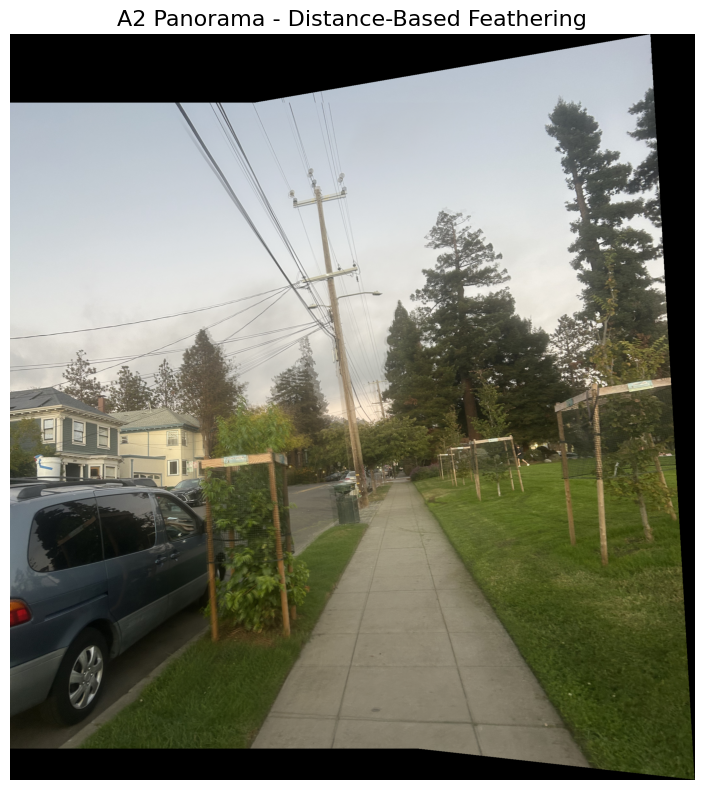

In [76]:
# Build a2 mosaic with distance-based feathering
print("\nBuilding mosaic with distance-based feathering...")
start = time.time()
mosaic_a2_feathered = build_mosaic_feathered(images_a2, homographies_a2, interp='bilinear')
time_feathered_a2 = time.time() - start
print(f"time was {time_feathered_a2:.2f}s, shape: {mosaic_a2_feathered.shape}")

fig, ax = plt.subplots(1, 1, figsize=(20, 8))
ax.imshow(mosaic_a2_feathered)
ax.set_title('A2 Panorama - Distance-Based Feathering', fontsize=16)
ax.axis('off')
plt.tight_layout()
plt.savefig('mosaic_a2_feathered.jpg', dpi=150, bbox_inches='tight')
plt.show()



Comparing Blending Methods (A2 Panorama):


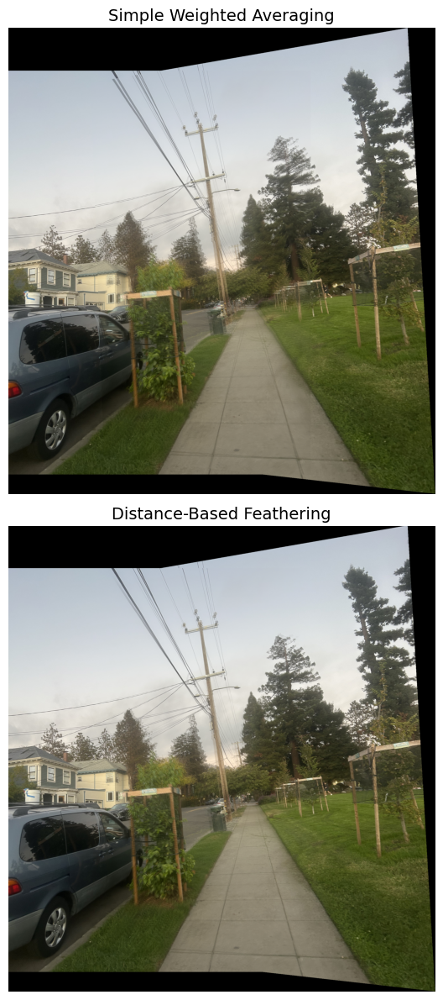


Timing:
  Simple averaging: 2.09s
  Feathering: 3.01s
  Overhead: 1.44x


In [77]:
# Compare blending methods for a2 panorama
print("\nComparing Blending Methods (A2 Panorama):")

fig, axes = plt.subplots(2, 1, figsize=(20, 12))

axes[0].imshow(mosaic_a2)
axes[0].set_title('Simple Weighted Averaging', fontsize=14)
axes[0].axis('off')

axes[1].imshow(mosaic_a2_feathered)
axes[1].set_title('Distance-Based Feathering', fontsize=14)
axes[1].axis('off')

plt.tight_layout()
plt.savefig('mosaic_a2_comparison.jpg', dpi=150, bbox_inches='tight')
plt.show()

print(f"\nTiming:")
print(f"  Simple averaging: {time_simple_a2:.2f}s")
print(f"  Feathering: {time_feathered_a2:.2f}s")
print(f"  Overhead: {time_feathered_a2/time_simple_a2:.2f}x")
